In [64]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import os
import numpy as np
import pandas as pd
import cartopy.feature as cfeature
import cartopy.crs as ccrs
import cartopy.feature as cfeat
from collections import defaultdict

import os
import torch
import numpy as np
from collections import defaultdict

def load_monthly_predictions(month, year, model_name, folder, space_buffer, threshold, pfts):
    """
    Charge les prédictions journalières pour un mois donné et retourne les moyennes mensuelles.

    Args:
        month (int): Le mois (1-12).
        year (int): L'année.
        model_name (str): Nom du modèle.
        folder (str): Chemin vers le dossier contenant les fichiers journaliers.
        space_buffer (int or str): Taille du buffer spatial ou "OCCCI".
        threshold (float): Seuil utilisé pour la prédiction.
        pfts (bool): True si on traite les PFTs, False pour TChla.

    Returns:
        tuple: latitudes, longitudes, moyennes mensuelles (tchla ou micro/nano/pico)
    """
    data_dict = defaultdict(list)

    for day in range(1, 32):
        try:
            if pfts:
                if model_name == "OCCCI":
                    file_path_micro = os.path.join(folder, f'{day}/prediction_MICRO_space_16_{year}{month}{day}.pt')
                    file_path_nano  = os.path.join(folder, f'{day}/prediction_NANO_space_16_{year}{month}{day}.pt')
                    file_path_pico  = os.path.join(folder, f'{day}/prediction_PICO_space_16_{year}{month}{day}.pt')
                    prediction_micro = torch.load(file_path_micro)
                    prediction_nano  = torch.load(file_path_nano)
                    prediction_pico  = torch.load(file_path_pico)

                    lat = prediction_micro[:, 0].cpu().numpy()
                    lon = prediction_micro[:, 1].cpu().numpy()
                    micro_day = prediction_micro[:, 2].cpu().numpy()
                    nano_day = prediction_nano[:, 2].cpu().numpy()
                    pico_day = prediction_pico[:, 2].cpu().numpy()

                else : 
                    file_path = os.path.join(folder, f'{day}/boxcox_pfts_prediction_space_{space_buffer}_{year}{month}{day}_t_{threshold}.pt')
                    prediction = torch.load(file_path)

                    lat = prediction[:, 0].cpu().numpy()
                    lon = prediction[:, 1].cpu().numpy()
                    micro_day = prediction[:, 2].cpu().numpy()
                    nano_day = prediction[:, 3].cpu().numpy()
                    pico_day = prediction[:, 4].cpu().numpy()

                for la, lo, val1, val2, val3 in zip(lat, lon, micro_day, nano_day, pico_day):
                    key = (round(la, 4), round(lo, 4))
                    data_dict[key].append((val1, val2, val3))

            else:
                if model_name == "OCCCI":
                    file_path = os.path.join(folder, f'{day}/prediction_CHL_space_16_{year}{month:02d}{day:02d}.pt')
                else:
                    file_path = os.path.join(folder, f'{day}/prediction_space_{space_buffer}_{year}{month}{day}_t_{threshold}.pt')

                prediction = torch.load(file_path)

                lat = prediction[:, 0].cpu().numpy()
                lon = prediction[:, 1].cpu().numpy()
                tchla_day = prediction[:, 2].cpu().numpy()

                for la, lo, val in zip(lat, lon, tchla_day):
                    key = (round(la, 4), round(lo, 4))
                    data_dict[key].append(val)

        except FileNotFoundError:
            print(f"Fichier manquant pour le jour {day}, ignoré.")
            continue

    latitudes = []
    longitudes = []

    if pfts:
        micro = []
        nano = []
        pico = []

        for (la, lo), values in data_dict.items():
            val1s, val2s, val3s = zip(*values)
            latitudes.append(la)
            longitudes.append(lo)
            micro.append(np.nanmean(val1s))
            nano.append(np.nanmean(val2s))
            pico.append(np.nanmean(val3s))

        return np.array(latitudes), np.array(longitudes), np.array(micro), np.array(nano), np.array(pico)

    else:
        tchla_means = []

        for (la, lo), values in data_dict.items():
            latitudes.append(la)
            longitudes.append(lo)
            tchla_means.append(np.nanmean(values))

        return np.array(latitudes), np.array(longitudes), np.array(tchla_means)


def plot_predictions(longitudes, latitudes, values, title):
    """
    Affiche les prédictions TCHLA sur une carte avec Cartopy,
    avec une colorbar dont le maximum est fixé à 3.
    """

    mask_valid = ~np.isnan(values)
    mask_black_sea = ~((longitudes >= 27) & (longitudes <= 42) &
                       (latitudes >= 40) & (latitudes <= 47))
    mask = mask_valid & mask_black_sea

    
    fig = plt.figure(figsize=(12, 6))
    ax = plt.axes(projection=ccrs.PlateCarree())

    # Normalisation logarithmique avec un maximum à 3
    norm = mcolors.LogNorm(vmin=0.01, vmax=3)

    ax.add_feature(cfeat.LAND, facecolor='lightgray')
    ax.coastlines(color='gray')
    # Nuage de points
    scatter = ax.scatter(longitudes, latitudes, c=values, cmap='viridis', s=1,
                         transform=ccrs.PlateCarree(), norm=norm)

    # Barre de couleur
    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=20, shrink=0.6)
    cbar.set_label('Prediction (mg.m⁻³)')
    cbar.set_ticks([0.01, 0.03, 0.1, 0.3, 1, 3])
    cbar.set_ticklabels(['0.01', '0.03', '0.1', '0.3', '1', '3'])

    # Grilles
    gl = ax.gridlines(draw_labels=True, linewidth=1, color='grey', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xlabel_style = {'size': 10}
    gl.ylabel_style = {'size': 10}

    plt.title(title, fontsize=14, weight='bold')
    plt.show()


import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import cartopy.crs as ccrs
import cartopy.feature as cfeat

def plot_predictions_frac(longitudes, latitudes, values, title):
    mask_valid = ~np.isnan(values)
    mask_black_sea = ~((longitudes >= 27) & (longitudes <= 42) &
                       (latitudes >= 40) & (latitudes <= 47))
    mask = mask_valid & mask_black_sea
    
    fig = plt.figure(figsize=(12, 6))
    ax = plt.axes(projection=ccrs.PlateCarree())

    # Échelle linéaire entre 0 et 1
    norm = mcolors.Normalize(vmin=0, vmax=1)

    # Fond et frontières
    ax.add_feature(cfeat.LAND, facecolor='lightgray')
    ax.coastlines(color='gray')

    # Nuage de points
    scatter = ax.scatter(longitudes, latitudes, c=values, cmap='viridis', s=4,
                         transform=ccrs.PlateCarree(), norm=norm)

    # Barre de couleur
    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=20, shrink=0.6)
    cbar.set_label('Predicted Concentration (fraction)', fontsize=12)
    cbar.set_ticks([0, 0.1, 0.2, 0.4, 0.6, 0.8, 1.0])
    cbar.ax.tick_params(labelsize=10)

    # Lignes de latitude/longitude
    gl = ax.gridlines(draw_labels=False, linewidth=1, color='grey', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xlabel_style = {'size': 12}
    gl.ylabel_style = {'size': 12}

    plt.title(title, fontsize=14, weight='bold')
    plt.tight_layout()
    plt.show()


/tmp/ipykernel_3801425/3126790226.py:43: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  prediction_micro = torch.load(file_path_micro)
/tmp/ipykernel_3801425/3126790226.py:44

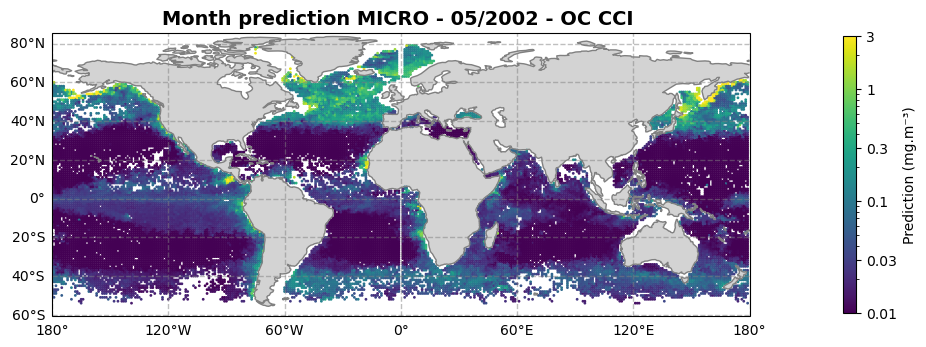

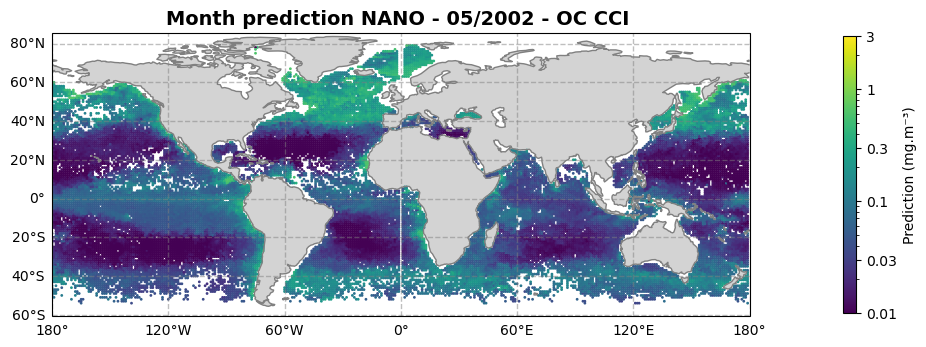

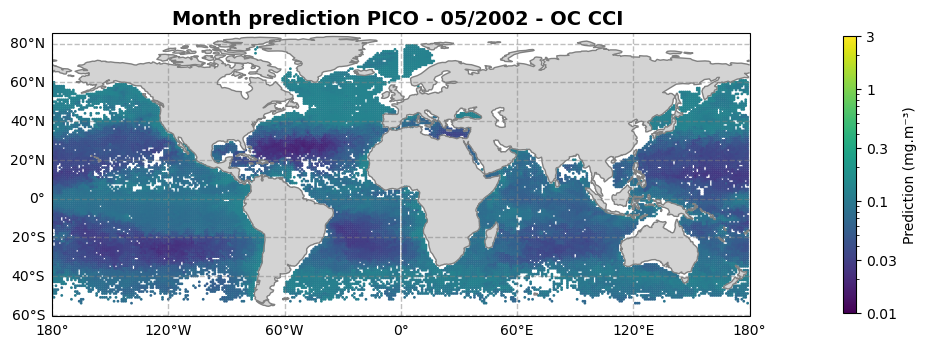

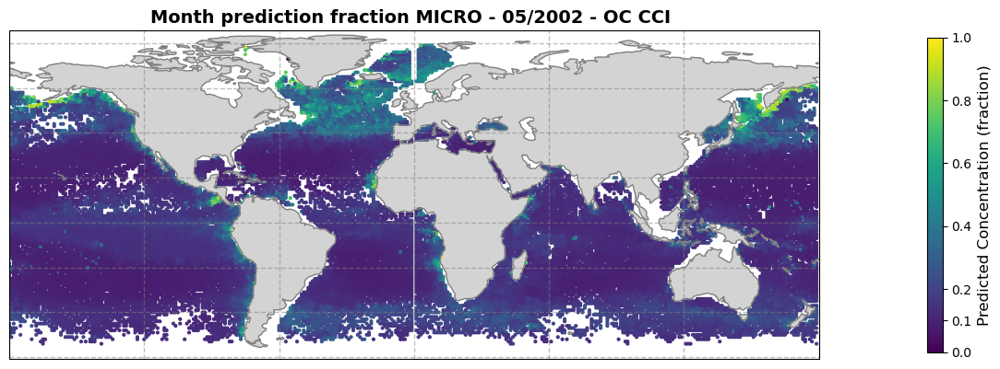

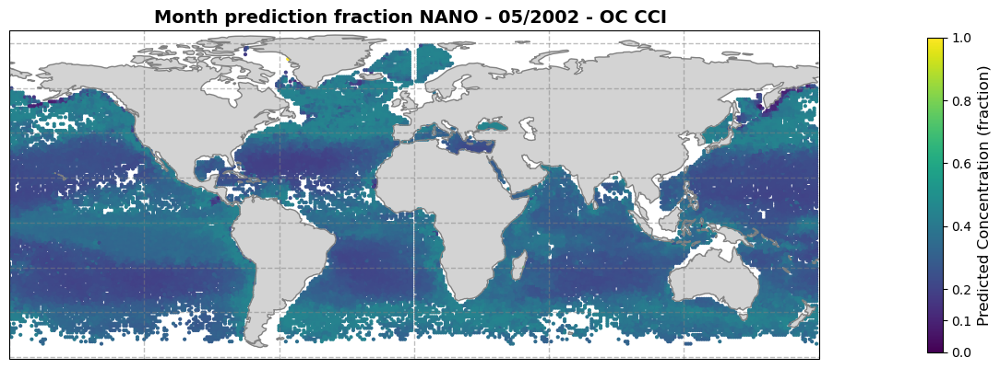

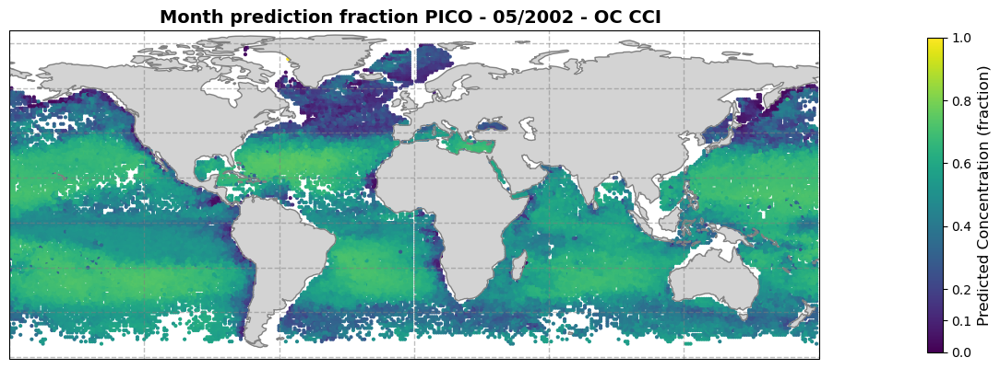

In [70]:
# Paramètres
month = 5
year = 2002

threshold = 0.99

# OC CCI
pfts = True
model_name = "OCCCI"
folder = f'/home/elabourdette/complex/share/save_training_Enza/inference/{year}/{month}/output/{model_name}'
title = f'Month prediction MICRO - {month:02d}/{year} - OC CCI '
latitudes_16_OCCCI_099, longitudes_16_OCCCI_099, micro_means_16_OCCCI_099, nano_means_16_OCCCI_099, pico_means_16_OCCCI_099 = load_monthly_predictions(month, year, model_name, folder, space_buffer, threshold, pfts)
plot_predictions(longitudes_16_OCCCI_099, latitudes_16_OCCCI_099, micro_means_16_OCCCI_099, title)
title = f'Month prediction NANO - {month:02d}/{year} - OC CCI '
plot_predictions(longitudes_16_OCCCI_099, latitudes_16_OCCCI_099, nano_means_16_OCCCI_099, title)
title = f'Month prediction PICO - {month:02d}/{year} - OC CCI '
plot_predictions(longitudes_16_OCCCI_099, latitudes_16_OCCCI_099, pico_means_16_OCCCI_099, title)


df_OCCCI_099_PFTS = pd.DataFrame({
    'lon': longitudes_16_OCCCI_099,
    'lat': latitudes_16_OCCCI_099,
    'micro': micro_means_16_OCCCI_099,
    'nano': nano_means_16_OCCCI_099,
    'pico': pico_means_16_OCCCI_099,
    'tchla_sum': micro_means_16_OCCCI_099 + nano_means_16_OCCCI_099 + pico_means_16_OCCCI_099, 
    'frac_micro': micro_means_16_OCCCI_099/(micro_means_16_OCCCI_099 + nano_means_16_OCCCI_099 + pico_means_16_OCCCI_099), 
    'frac_nano': nano_means_16_OCCCI_099/(micro_means_16_OCCCI_099 + nano_means_16_OCCCI_099 + pico_means_16_OCCCI_099), 
    'frac_pico': pico_means_16_OCCCI_099/(micro_means_16_OCCCI_099 + nano_means_16_OCCCI_099 + pico_means_16_OCCCI_099)
})
title = f'Month prediction fraction MICRO - {month:02d}/{year} - OC CCI '
plot_predictions_frac(longitudes_16_OCCCI_099, latitudes_16_OCCCI_099, df_OCCCI_099_PFTS['frac_micro'], title)
title = f'Month prediction fraction NANO - {month:02d}/{year} - OC CCI '
plot_predictions_frac(longitudes_16_OCCCI_099, latitudes_16_OCCCI_099, df_OCCCI_099_PFTS['frac_nano'], title)
title = f'Month prediction fraction PICO - {month:02d}/{year} - OC CCI '
plot_predictions_frac(longitudes_16_OCCCI_099, latitudes_16_OCCCI_099, df_OCCCI_099_PFTS['frac_pico'], title)


/tmp/ipykernel_3801425/3126790226.py:55: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  prediction = torch.load(file_path)


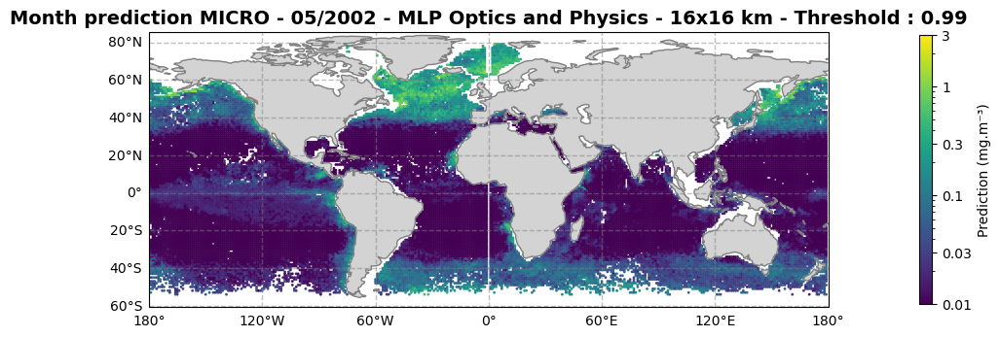

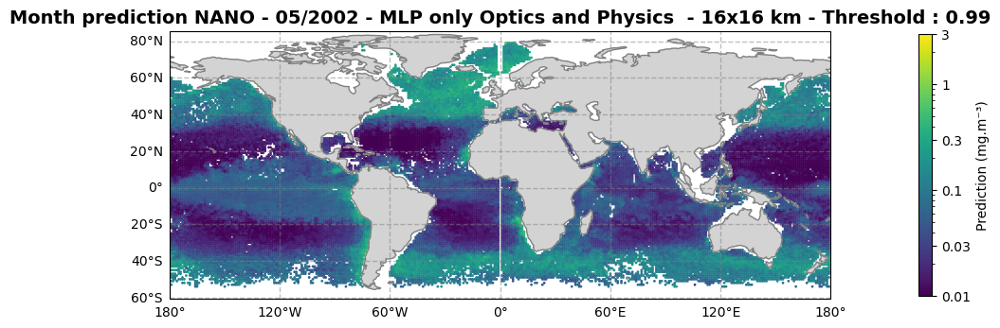

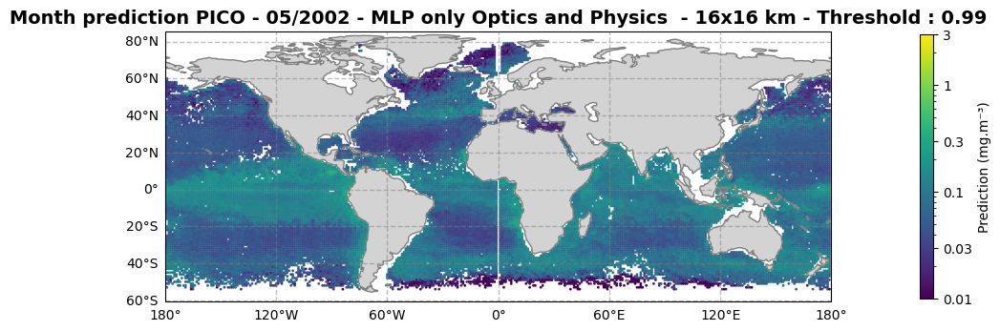

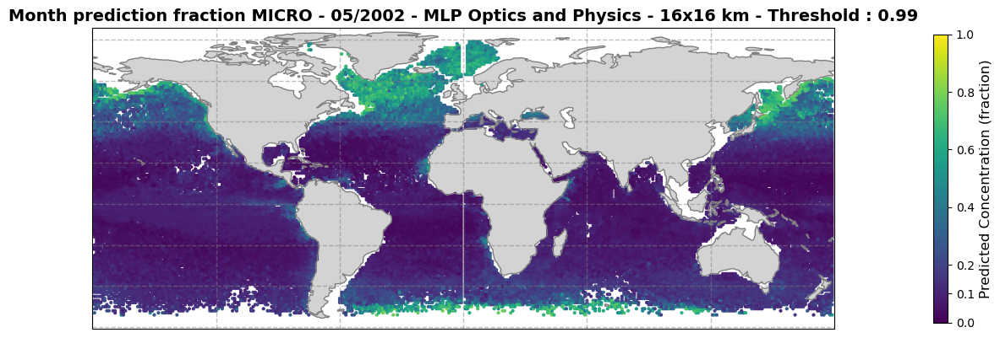

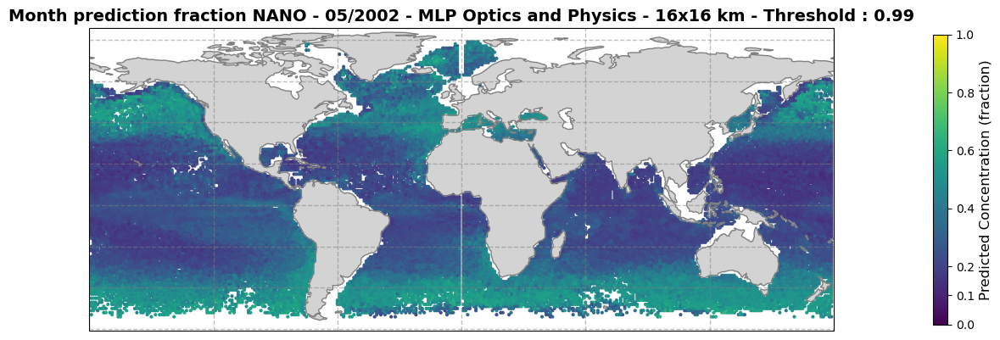

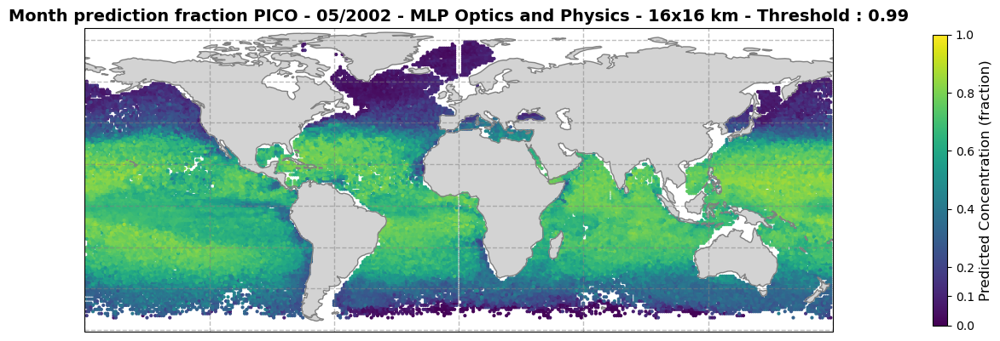

In [66]:
# Paramètres
month = 5
year = 2002

space_buffer = 8

threshold = 0.99

# MODEL 2 
pfts = True
model_name = "MLP_model2_after_EGU_0.99"
folder = f'/home/elabourdette/complex/share/save_training_Enza/inference/{year}/{month}/output/{model_name}'
title = f'Month prediction MICRO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
latitudes_16_MLP2_099, longitudes_16_MLP2_099, micro_means_16_MLP2_099, nano_means_16_MLP2_099, pico_means_16_MLP2_099 = load_monthly_predictions(month, year, model_name, folder, space_buffer, threshold, pfts)
plot_predictions(longitudes_16_MLP2_099, latitudes_16_MLP2_099, micro_means_16_MLP2_099, title)
title = f'Month prediction NANO - {month:02d}/{year} - MLP only Optics and Physics  - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions(longitudes_16_MLP2_099, latitudes_16_MLP2_099, nano_means_16_MLP2_099, title)
title = f'Month prediction PICO - {month:02d}/{year} - MLP only Optics and Physics  - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions(longitudes_16_MLP2_099, latitudes_16_MLP2_099, pico_means_16_MLP2_099, title)


df_16_MLP2_099_PFTS = pd.DataFrame({
    'lon': longitudes_16_MLP2_099,
    'lat': latitudes_16_MLP2_099,
    'micro': micro_means_16_MLP2_099,
    'nano': nano_means_16_MLP2_099,
    'pico': pico_means_16_MLP2_099,
    'tchla_sum': micro_means_16_MLP2_099 + nano_means_16_MLP2_099 + pico_means_16_MLP2_099, 
    'frac_micro': micro_means_16_MLP2_099/(micro_means_16_MLP2_099 + nano_means_16_MLP2_099 + pico_means_16_MLP2_099), 
    'frac_nano': nano_means_16_MLP2_099/(micro_means_16_MLP2_099 + nano_means_16_MLP2_099 + pico_means_16_MLP2_099), 
    'frac_pico': pico_means_16_MLP2_099/(micro_means_16_MLP2_099 + nano_means_16_MLP2_099 + pico_means_16_MLP2_099)
})
title = f'Month prediction fraction MICRO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_16_MLP2_099, latitudes_16_MLP2_099, df_16_MLP2_099_PFTS['frac_micro'], title)
title = f'Month prediction fraction NANO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_16_MLP2_099, latitudes_16_MLP2_099, df_16_MLP2_099_PFTS['frac_nano'], title)
title = f'Month prediction fraction PICO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_16_MLP2_099, latitudes_16_MLP2_099, df_16_MLP2_099_PFTS['frac_pico'], title)

/tmp/ipykernel_3801425/3126790226.py:55: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  prediction = torch.load(file_path)


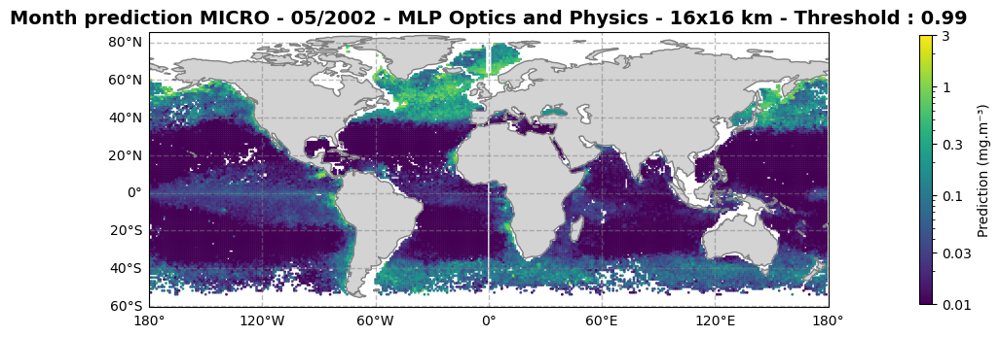

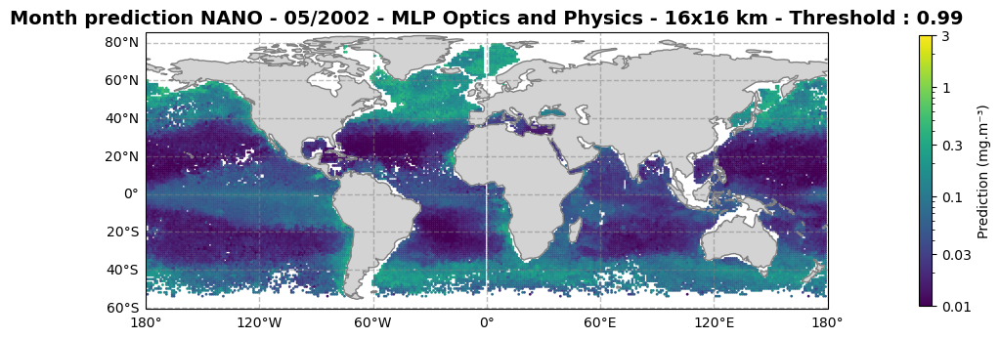

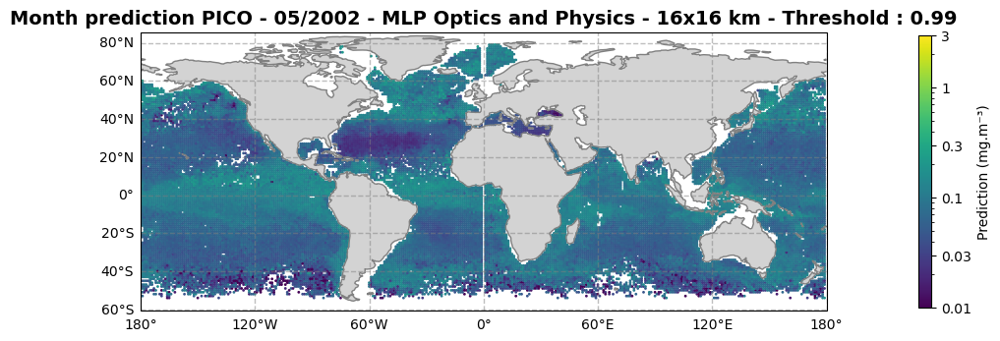

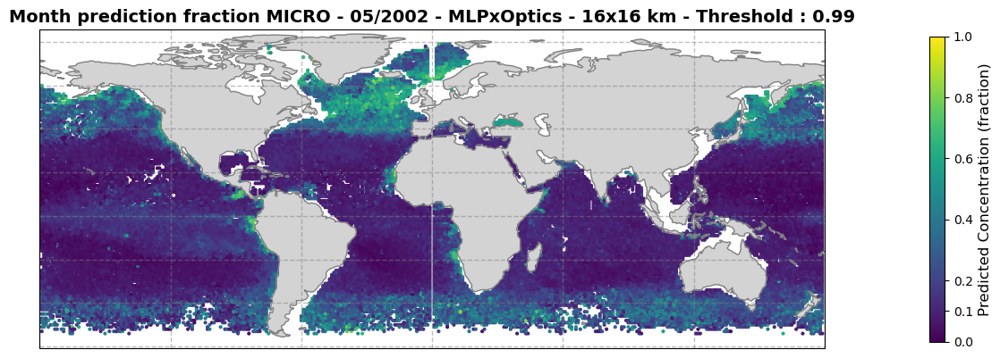

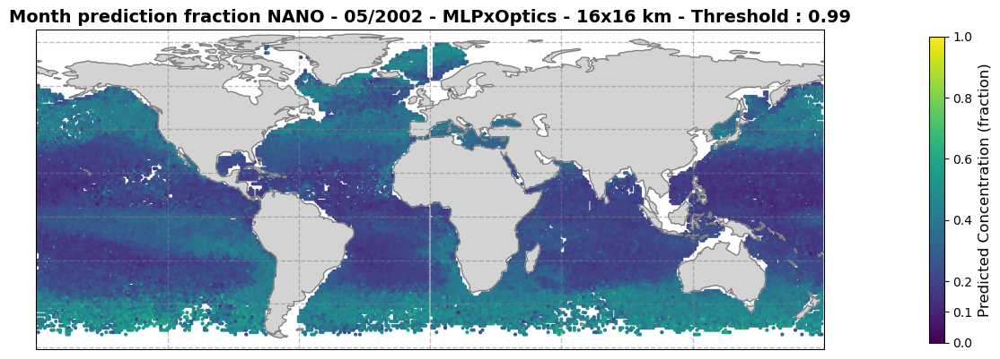

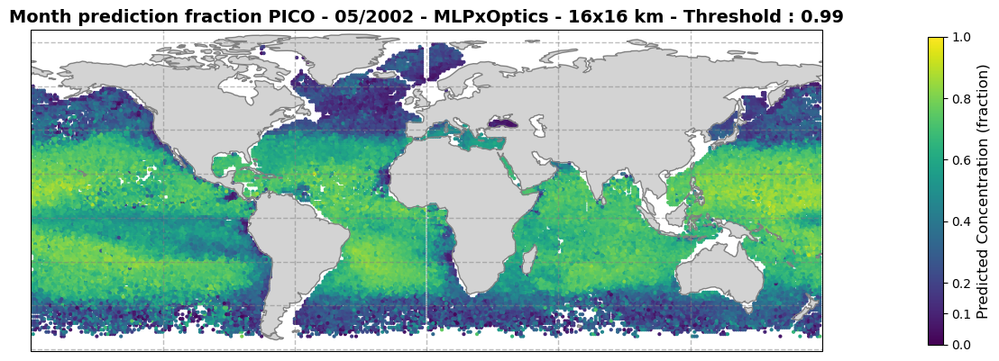

In [67]:
# Paramètres
month = 5
year = 2002

space_buffer = 8

threshold = 0.99

# MODEL 1 
pfts = True
model_name = "MLP_model1_after_EGU_0.99"
folder = f'/home/elabourdette/complex/share/save_training_Enza/inference/{year}/{month}/output/{model_name}'
title = f'Month prediction MICRO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
latitudes_16_MLP1_099, longitudes_16_MLP1_099, micro_means_16_MLP1_099, nano_means_16_MLP1_099, pico_means_16_MLP1_099 = load_monthly_predictions(month, year, model_name, folder, space_buffer, threshold, pfts)
plot_predictions(longitudes_16_MLP1_099, latitudes_16_MLP1_099, micro_means_16_MLP1_099, title)
title = f'Month prediction NANO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions(longitudes_16_MLP1_099, latitudes_16_MLP1_099, nano_means_16_MLP1_099, title)
title = f'Month prediction PICO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions(longitudes_16_MLP1_099, latitudes_16_MLP1_099, pico_means_16_MLP1_099, title)

df_16_MLP1_099_PFTS = pd.DataFrame({
    'lon': longitudes_16_MLP1_099,
    'lat': latitudes_16_MLP1_099,
    'micro': micro_means_16_MLP1_099,
    'nano': nano_means_16_MLP1_099,
    'pico': pico_means_16_MLP1_099,
    'tchla_sum': micro_means_16_MLP1_099 + nano_means_16_MLP1_099 + pico_means_16_MLP1_099, 
    'frac_micro': micro_means_16_MLP1_099/(micro_means_16_MLP1_099 + nano_means_16_MLP1_099 + pico_means_16_MLP1_099), 
    'frac_nano': nano_means_16_MLP1_099/(micro_means_16_MLP1_099 + nano_means_16_MLP1_099 + pico_means_16_MLP1_099), 
    'frac_pico': pico_means_16_MLP1_099/(micro_means_16_MLP1_099 + nano_means_16_MLP1_099 + pico_means_16_MLP1_099)
})
title = f'Month prediction fraction MICRO - {month:02d}/{year} - MLPxOptics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_16_MLP1_099, latitudes_16_MLP1_099, df_16_MLP1_099_PFTS['frac_micro'], title)
title = f'Month prediction fraction NANO - {month:02d}/{year} - MLPxOptics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_16_MLP1_099, latitudes_16_MLP1_099, df_16_MLP1_099_PFTS['frac_nano'], title)
title = f'Month prediction fraction PICO - {month:02d}/{year} - MLPxOptics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_16_MLP1_099, latitudes_16_MLP1_099, df_16_MLP1_099_PFTS['frac_pico'], title)

/tmp/ipykernel_3801425/3126790226.py:55: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  prediction = torch.load(file_path)


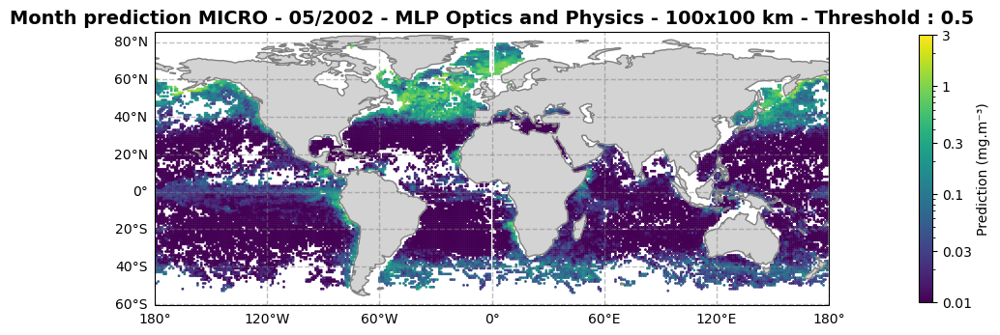

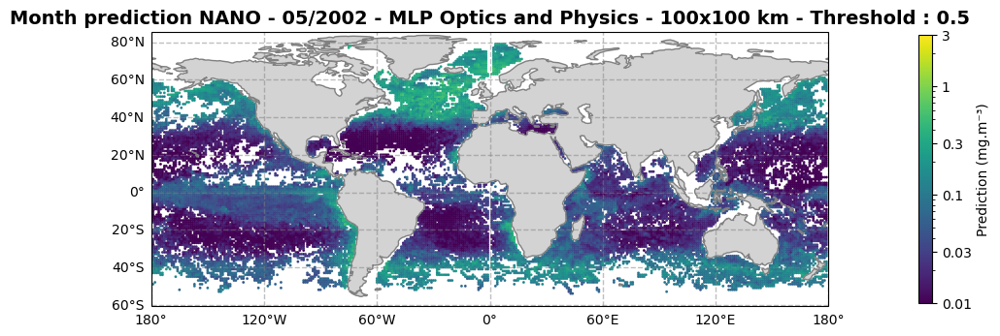

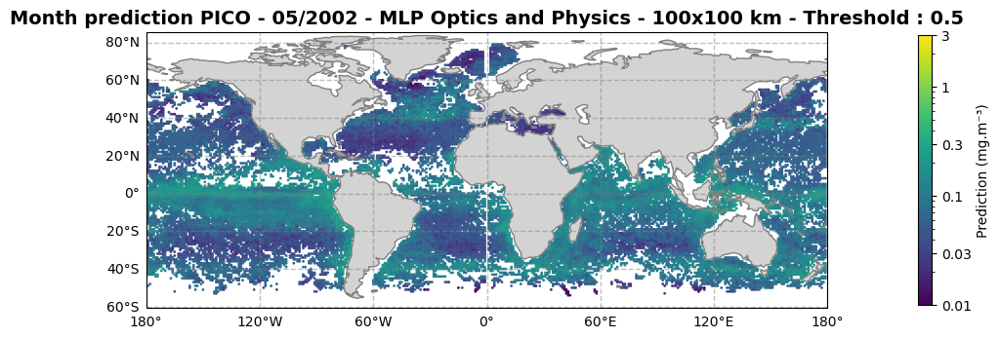

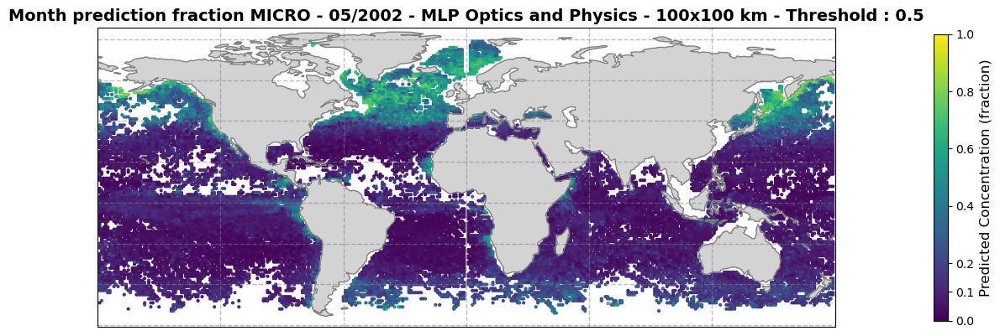

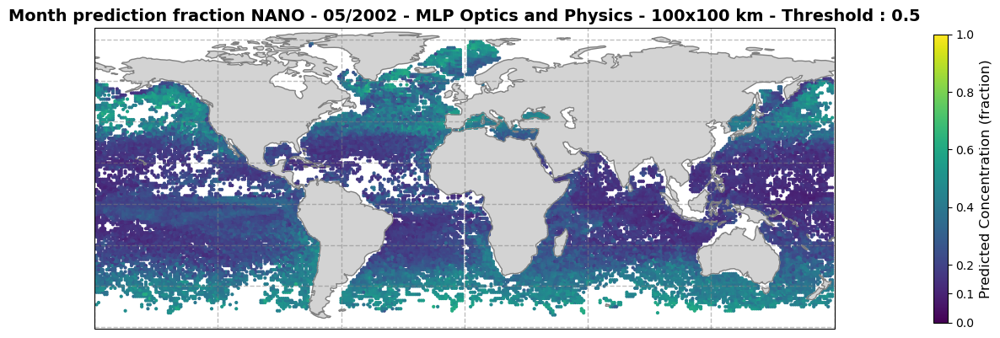

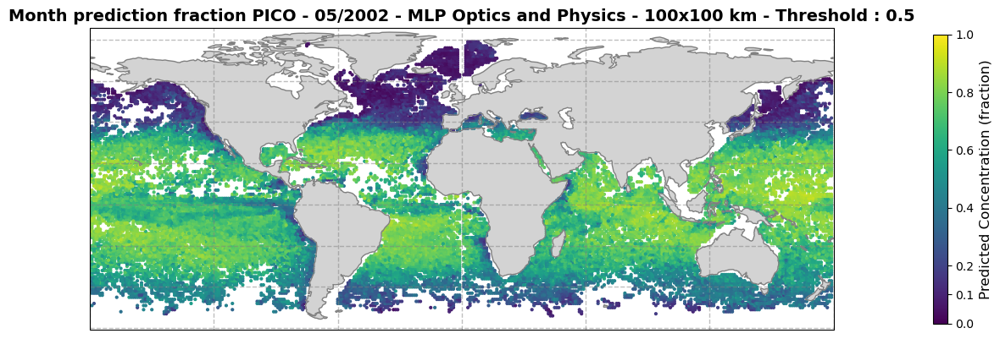

In [68]:
# Paramètres
month = 5
year = 2002

space_buffer = 50

threshold = 0.5

# MODEL 2 
pfts = True
model_name = f"MLP_model2_after_EGU_{threshold}"
folder = f'/home/elabourdette/complex/share/save_training_Enza/inference/{year}/{month}/output/{model_name}'
title = f'Month prediction MICRO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
latitudes_100_MLP2_05, longitudes_100_MLP2_05, micro_means_100_MLP2_05, nano_means_100_MLP2_05, pico_means_100_MLP2_05 = load_monthly_predictions(month, year, model_name, folder, space_buffer, threshold, pfts)
plot_predictions(longitudes_100_MLP2_05, latitudes_100_MLP2_05, micro_means_100_MLP2_05, title)
title = f'Month prediction NANO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions(longitudes_100_MLP2_05, latitudes_100_MLP2_05, nano_means_100_MLP2_05, title)
title = f'Month prediction PICO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions(longitudes_100_MLP2_05, latitudes_100_MLP2_05, pico_means_100_MLP2_05, title)

df_100_MLP2_05_PFTS = pd.DataFrame({
    'lon': longitudes_100_MLP2_05,
    'lat': latitudes_100_MLP2_05,
    'micro': micro_means_100_MLP2_05,
    'nano': nano_means_100_MLP2_05,
    'pico': pico_means_100_MLP2_05,
    'tchla_sum': micro_means_100_MLP2_05 + nano_means_100_MLP2_05 + pico_means_100_MLP2_05, 
    'frac_micro': micro_means_100_MLP2_05/(micro_means_100_MLP2_05 + nano_means_100_MLP2_05 + pico_means_100_MLP2_05), 
    'frac_nano': nano_means_100_MLP2_05/(micro_means_100_MLP2_05 + nano_means_100_MLP2_05 + pico_means_100_MLP2_05), 
    'frac_pico': pico_means_100_MLP2_05/(micro_means_100_MLP2_05 + nano_means_100_MLP2_05 + pico_means_100_MLP2_05)
})
title = f'Month prediction fraction MICRO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_100_MLP2_05, latitudes_100_MLP2_05, df_100_MLP2_05_PFTS['frac_micro'], title)
title = f'Month prediction fraction NANO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_100_MLP2_05, latitudes_100_MLP2_05, df_100_MLP2_05_PFTS['frac_nano'], title)
title = f'Month prediction fraction PICO - {month:02d}/{year} - MLP Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_100_MLP2_05, latitudes_100_MLP2_05, df_100_MLP2_05_PFTS['frac_pico'], title)

/tmp/ipykernel_3801425/3126790226.py:55: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  prediction = torch.load(file_path)


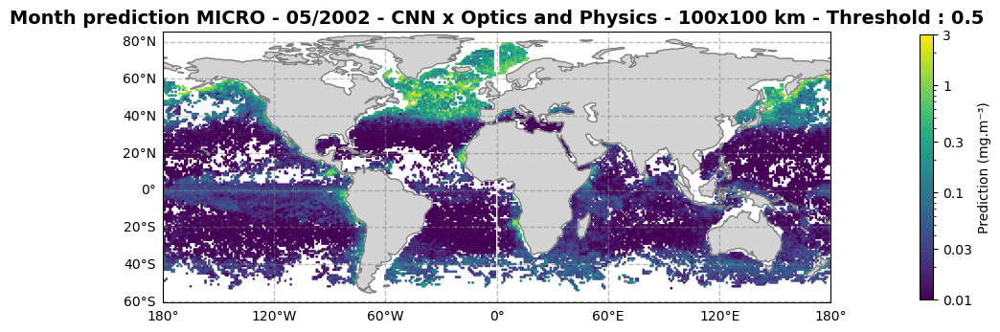

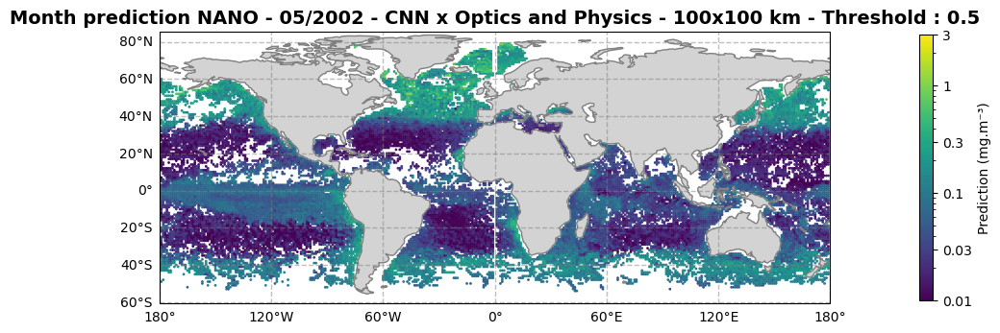

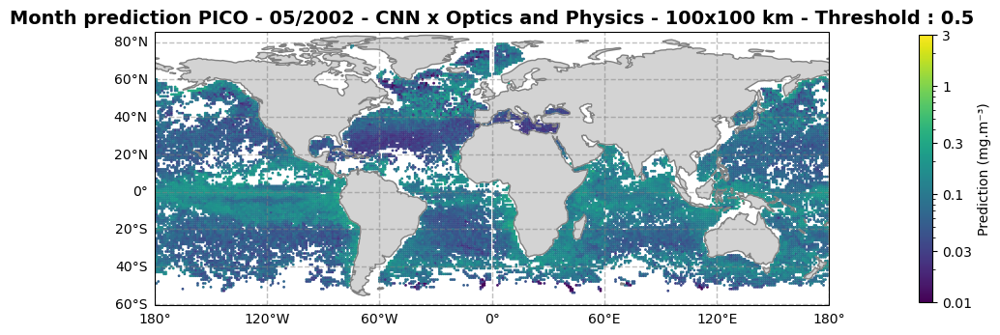

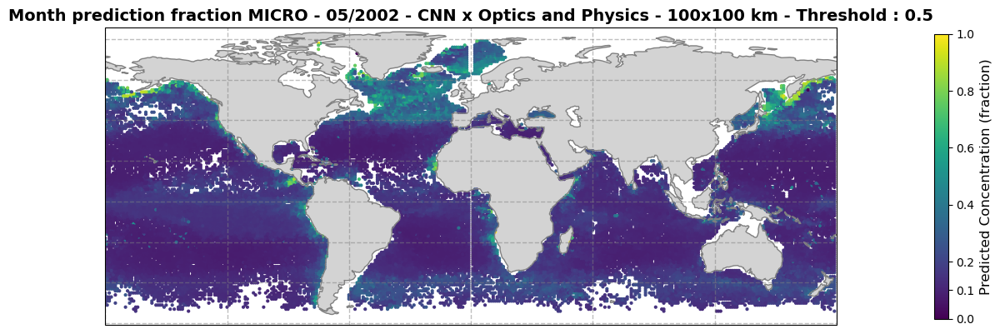

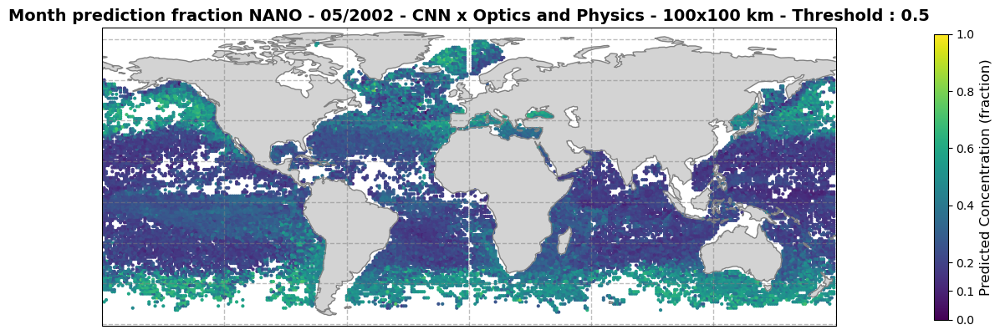

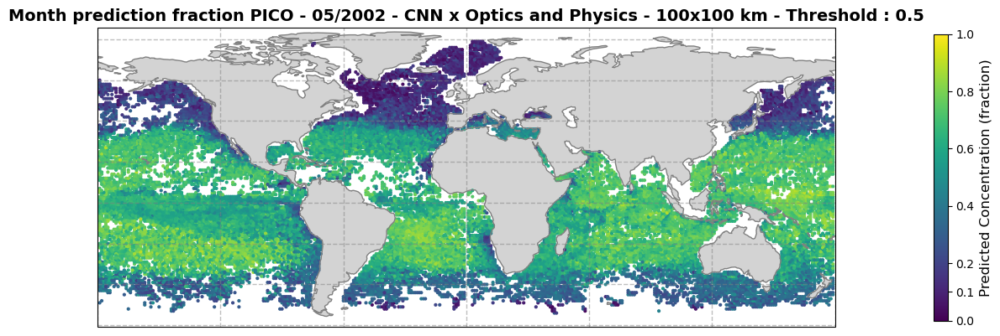

In [69]:
# Paramètres
month = 5
year = 2002

space_buffer = 50

threshold = 0.5

# MODEL 3 
pfts = True
model_name = f"MLP_model3_after_EGU_{threshold}"
folder = f'/home/elabourdette/complex/share/save_training_Enza/inference/{year}/{month}/output/{model_name}'
title = f'Month prediction MICRO - {month:02d}/{year} - CNN x Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
latitudes_100_MLP3_05, longitudes_100_MLP3_05, micro_means_100_MLP3_05, nano_means_100_MLP3_05, pico_means_100_MLP3_05 = load_monthly_predictions(month, year, model_name, folder, space_buffer, threshold, pfts)
plot_predictions(longitudes_100_MLP3_05, latitudes_100_MLP3_05, micro_means_100_MLP3_05, title)
title = f'Month prediction NANO - {month:02d}/{year} - CNN x Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions(longitudes_100_MLP3_05, latitudes_100_MLP3_05, nano_means_100_MLP3_05, title)
title = f'Month prediction PICO - {month:02d}/{year} - CNN x Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions(longitudes_100_MLP3_05, latitudes_100_MLP3_05, pico_means_100_MLP3_05, title)

df_100_MLP3_05_PFTS = pd.DataFrame({
    'lon': longitudes_100_MLP3_05,
    'lat': latitudes_100_MLP3_05,
    'micro': micro_means_100_MLP3_05,
    'nano': nano_means_100_MLP3_05,
    'pico': pico_means_100_MLP3_05,
    'tchla_sum': micro_means_100_MLP3_05 + nano_means_100_MLP3_05 + pico_means_100_MLP3_05, 
    'frac_micro': micro_means_100_MLP3_05/(micro_means_100_MLP3_05 + nano_means_100_MLP3_05 + pico_means_100_MLP3_05), 
    'frac_nano': nano_means_100_MLP3_05/(micro_means_100_MLP3_05 + nano_means_100_MLP3_05 + pico_means_100_MLP3_05), 
    'frac_pico': pico_means_100_MLP3_05/(micro_means_100_MLP3_05 + nano_means_100_MLP3_05 + pico_means_100_MLP3_05)
})
title = f'Month prediction fraction MICRO - {month:02d}/{year} - CNN x Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_16_OCCCI_099, latitudes_16_OCCCI_099, df_OCCCI_099_PFTS['frac_micro'], title)
title = f'Month prediction fraction NANO - {month:02d}/{year} - CNN x Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_100_MLP3_05, latitudes_100_MLP3_05, df_100_MLP3_05_PFTS['frac_nano'], title)
title = f'Month prediction fraction PICO - {month:02d}/{year} - CNN x Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_frac(longitudes_100_MLP3_05, latitudes_100_MLP3_05, df_100_MLP3_05_PFTS['frac_pico'], title)

/tmp/ipykernel_3801425/1187473892.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


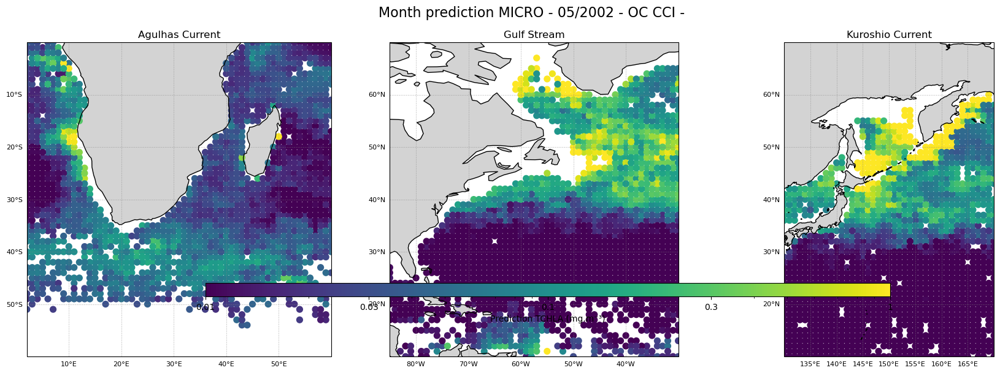

/tmp/ipykernel_3801425/1187473892.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


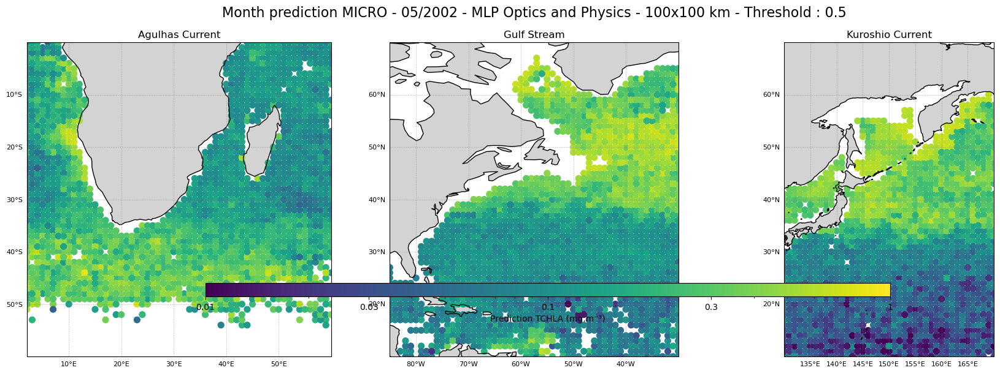

/tmp/ipykernel_3801425/1187473892.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


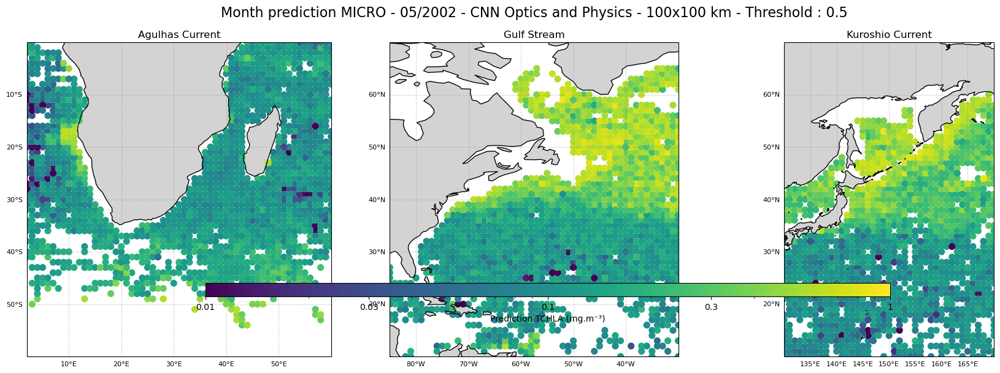

In [42]:
def plot_predictions_filtered(longitudes, latitudes, values, title):
    """
    Affiche les prédictions TCHLA pour Agulhas, Gulf Stream, et Kuroshio sur 3 cartes,
    avec une colorbar dont le maximum est fixé à 1.
    """

    # Convertir en tableaux numpy
    longitudes = np.array(longitudes)
    latitudes = np.array(latitudes)
    values = np.array(values)

    # Définition des régions
    regions = {
        'Agulhas Current':    [2, 60, -60, -0],
        'Gulf Stream':        [-85, -30, 10, 70],
        'Kuroshio Current':   [130, 170, 10, 70],
    }

    # Normalisation logarithmique jusqu'à 1
    norm = mcolors.LogNorm(vmin=0.01, vmax=1)

    fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.PlateCarree()})
    fig.suptitle(title, fontsize=16)

    for ax, (region_name, (lon_min, lon_max, lat_min, lat_max)) in zip(axes, regions.items()):
        # Filtrer les données
        mask = (
            (longitudes >= lon_min) & (longitudes <= lon_max) &
            (latitudes >= lat_min) & (latitudes <= lat_max)
        )
        lons_region = longitudes[mask]
        lats_region = latitudes[mask]
        vals_region = values[mask]

        # Carte
        ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
        ax.add_feature(cfeat.LAND, facecolor='lightgray')
        ax.coastlines(color='black')

        scatter = ax.scatter(lons_region, lats_region, c=vals_region, cmap='viridis', s=50,
                             transform=ccrs.PlateCarree(), norm=norm)

        # Grilles
        gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
        gl.top_labels = False
        gl.right_labels = False
        gl.xlabel_style = {'size': 8}
        gl.ylabel_style = {'size': 8}

        ax.set_title(region_name)

    # Barre de couleur commune
    cbar = fig.colorbar(
        scatter,
        ax=axes.ravel().tolist(),
        orientation='horizontal',
        pad=0.1,
        aspect=50,
        shrink=0.8
    )
    cbar.set_label('Prediction TCHLA (mg.m⁻³)')
    cbar.set_ticks([0.01, 0.03, 0.1, 0.3, 1])
    cbar.set_ticklabels(['0.01', '0.03', '0.1', '0.3', '1'])

    plt.tight_layout()
    plt.subplots_adjust(top=0.88)
    plt.show()


# MODEL 2 
title = f'Month prediction MICRO - {month:02d}/{year} - OC CCI - '
plot_predictions_filtered(longitudes_16_OCCCI_099, latitudes_16_OCCCI_099, micro_means_16_OCCCI_099, title)

# MODEL 2 
space_buffer = 16
threshold = 
title = f'Month prediction MICRO - {month:02d}/{year} - MLP Optics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_filtered(longitudes_16_MLP1_099, latitudes_16_MLP1_099, df_16_MLP1_099_PFTS['frac_micro'], title)

# CNN 2
space_buffer = 100
title = f'Month prediction MICRO - {month:02d}/{year} - CNN Optics and Physics - {space_buffer*2}x{space_buffer*2} km - Threshold : {threshold}'
plot_predictions_filtered(longitudes_100_MLP3_05, latitudes_100_MLP3_05, df_100_MLP3_05_PFTS['frac_micro'], title)

In [39]:
df_16_MLP1_099_PFTS['frac_micro'].min(),df_16_MLP1_099_PFTS['frac_micro'].max()

(np.float32(0.002410708), np.float32(0.8522672))

In [ ]:
tchla_means_16_MLP1_099.min(), tchla_means_16_MLP2_099.min() 

In [ ]:
df_add_deep_099_PFTS = pd.merge(df_16_MLP1_099_PFTS, df_OCCCI_099_PFTS, on=['lon', 'lat'], how='inner')
df_add_deep_add_physics_099_PFTS = pd.merge(df_16_MLP2_099_PFTS, df_OCCCI_099_PFTS, on=['lon', 'lat'], how='inner')
df_add_physics_099_PFTS = pd.merge(df_16_MLP2_099_PFTS, df_OCCCI_099_PFTS, on=['lon', 'lat'], how='inner')

In [ ]:
def compute_diff(row, var):
    x = row[f'{var}_x']
    y = row[f'{var}_y']
    if np.isnan(x) or np.isnan(y):
        return np.nan
    return y - x

def compute_relative_diff(row, var):
    x = row[f'{var}_x']
    y = row[f'{var}_y']
    if np.isnan(x) or np.isnan(y) or y == 0:
        return np.nan
    return (y - x) / y

def compute_log_relative_diff(row, var):
    x = row[f'{var}_x']
    y = row[f'{var}_y']
    if np.isnan(x) or np.isnan(y) or x <= 0 or y <= 0:
        return np.nan
    return (np.log(y) - np.log(x)) / np.log(y)


In [46]:
variables = ['micro', 'nano', 'pico']

dfs = [df_add_deep_099_PFTS, df_add_deep_add_physics_099_PFTS, df_add_physics_099_PFTS]
for df in dfs: 
    for var in variables:
        df[f'diff_{var}'] = df.apply(lambda row: compute_diff(row, var), axis=1)
        df[f'diff_frac_{var}'] = df.apply(lambda row: compute_relative_diff(row, var), axis=1)
        df[f'diff_frac_log_{var}'] = df.apply(lambda row: compute_log_relative_diff(row, var), axis=1)


In [49]:
df_add_deep_099_PFTS.columns

Index(['lon', 'lat', 'micro_x', 'nano_x', 'pico_x', 'micro_y', 'nano_y',
       'pico_y', 'diff_micro', 'diff_frac_micro', 'diff_frac_log_micro',
       'diff_nano', 'diff_frac_nano', 'diff_frac_log_nano', 'diff_pico',
       'diff_frac_pico', 'diff_frac_log_pico'],
      dtype='object')

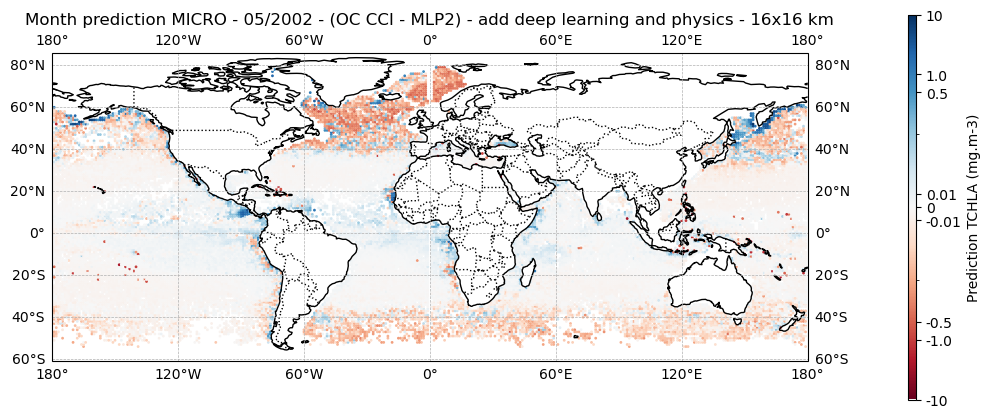

<Figure size 640x480 with 0 Axes>

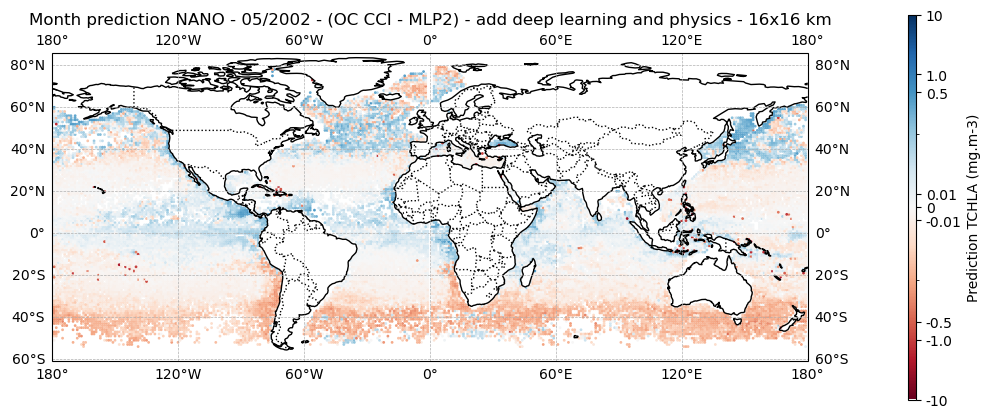

<Figure size 640x480 with 0 Axes>

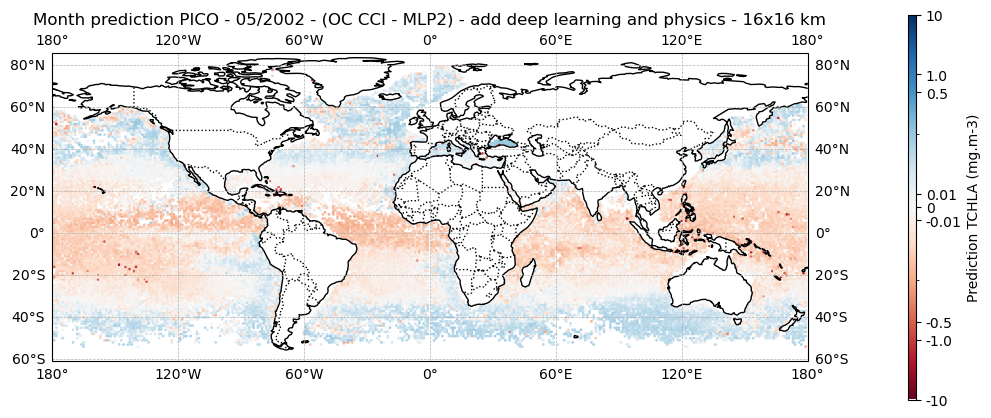

<Figure size 640x480 with 0 Axes>

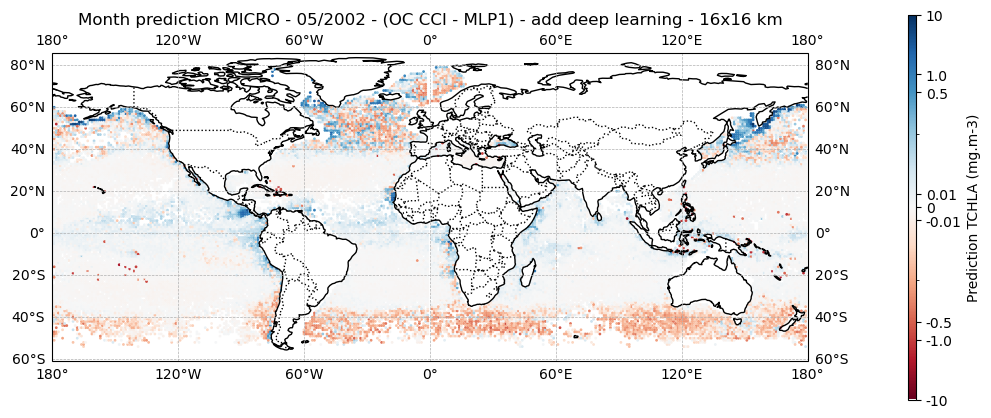

<Figure size 640x480 with 0 Axes>

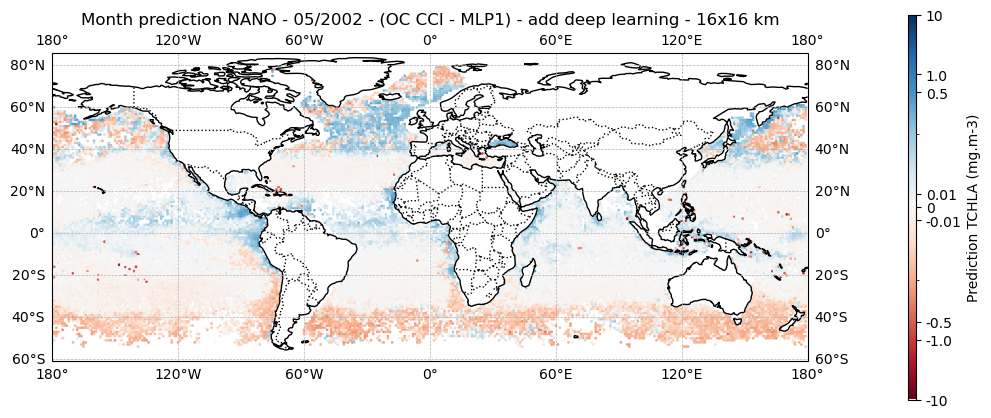

<Figure size 640x480 with 0 Axes>

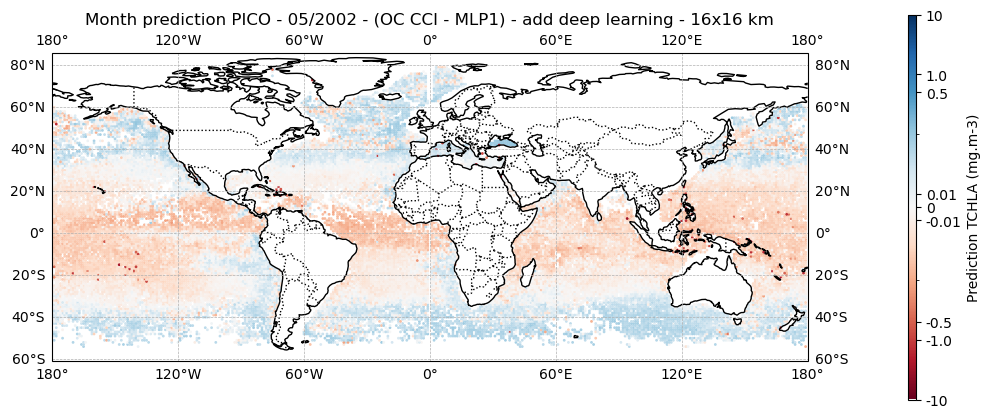

<Figure size 640x480 with 0 Axes>

In [55]:
def plot_predictions_difference(ax, longitudes, latitudes, values, title):
    # Using SymLogNorm with a range of -10 to 10
    norm = mcolors.SymLogNorm(linthresh=0.01, linscale=0.2, vmin=-10, vmax=10)

    # Creating the scatter plot with the modified color scale and colormap
    scatter = ax.scatter(longitudes, latitudes, c=values, cmap='RdBu', s=1, 
                         transform=ccrs.PlateCarree(), norm=norm)

    ax.coastlines(resolution='110m', color='black')
    ax.add_feature(cfeat.BORDERS, linestyle=':', edgecolor='black')
    ax.gridlines(draw_labels=True, linestyle='--', linewidth=0.5)
    ax.set_title(title) 
    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=50)
    cbar.set_label('Prediction TCHLA (mg.m-3)')
    # Custom tick locations
    cbar.set_ticks([-10, -1.0, -0.5, -0.01, 0, 0.01, 0.5, 1.0, 10])
    cbar.set_ticklabels(['-10','-1.0', '-0.5', '-0.01', '0', '0.01', '0.5','1.0', '10'])

    plt.title(title)
    plt.show()


#####################   MODEL 2    ######################################################

# MICRO
fig = plt.figure(figsize=(13, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference(
    ax,
    df_add_deep_add_physics_099_PFTS['lon'].values,
    df_add_deep_add_physics_099_PFTS['lat'].values,
    df_add_deep_add_physics_099_PFTS['diff_micro'].values,
    title=f'Month prediction MICRO - {month:02d}/{year} - (OC CCI - MLP2) - add deep learning and physics - 16x16 km'
)
plt.tight_layout()
plt.show()

# NANO
fig = plt.figure(figsize=(13, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference(
    ax,
    df_add_deep_add_physics_099_PFTS['lon'].values,
    df_add_deep_add_physics_099_PFTS['lat'].values,
    df_add_deep_add_physics_099_PFTS['diff_nano'].values,
    title=f'Month prediction NANO - {month:02d}/{year} - (OC CCI - MLP2) - add deep learning and physics - 16x16 km'
)
plt.tight_layout()
plt.show()

# PICO
fig = plt.figure(figsize=(13, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference(
    ax,
    df_add_deep_099_PFTS['lon'].values,
    df_add_deep_099_PFTS['lat'].values,
    df_add_deep_099_PFTS['diff_pico'].values,
    title=f'Month prediction PICO - {month:02d}/{year} - (OC CCI - MLP2) - add deep learning and physics - 16x16 km'
)
plt.tight_layout()
plt.show()

#####################   MODEL 1    ######################################################
# MICRO
fig = plt.figure(figsize=(13, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference(
    ax,
    df_add_deep_099_PFTS['lon'].values,
    df_add_deep_099_PFTS['lat'].values,
    df_add_deep_099_PFTS['diff_micro'].values,
    title=f'Month prediction MICRO - {month:02d}/{year} - (OC CCI - MLP1) - add deep learning - 16x16 km'
)
plt.tight_layout()
plt.show()

# NANO
fig = plt.figure(figsize=(13, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference(
    ax,
    df_add_deep_099_PFTS['lon'].values,
    df_add_deep_099_PFTS['lat'].values,
    df_add_deep_099_PFTS['diff_nano'].values,
    title=f'Month prediction NANO - {month:02d}/{year} - (OC CCI - MLP1) - add deep learning - 16x16 km'
)
plt.tight_layout()
plt.show()

# PICO
fig = plt.figure(figsize=(13, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference(
    ax,
    df_add_deep_099_PFTS['lon'].values,
    df_add_deep_099_PFTS['lat'].values,
    df_add_deep_099_PFTS['diff_pico'].values,
    title=f'Month prediction PICO - {month:02d}/{year} - (OC CCI - MLP1) - add deep learning - 16x16 km'
)
plt.tight_layout()
plt.show()

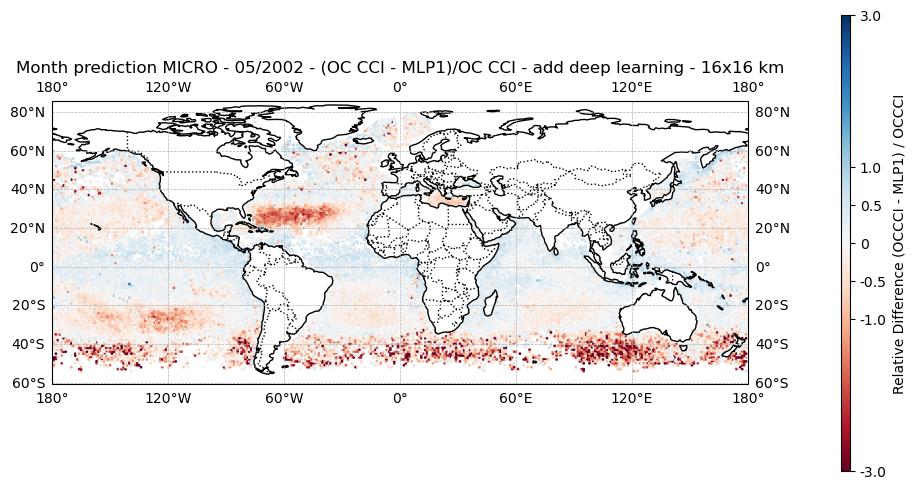

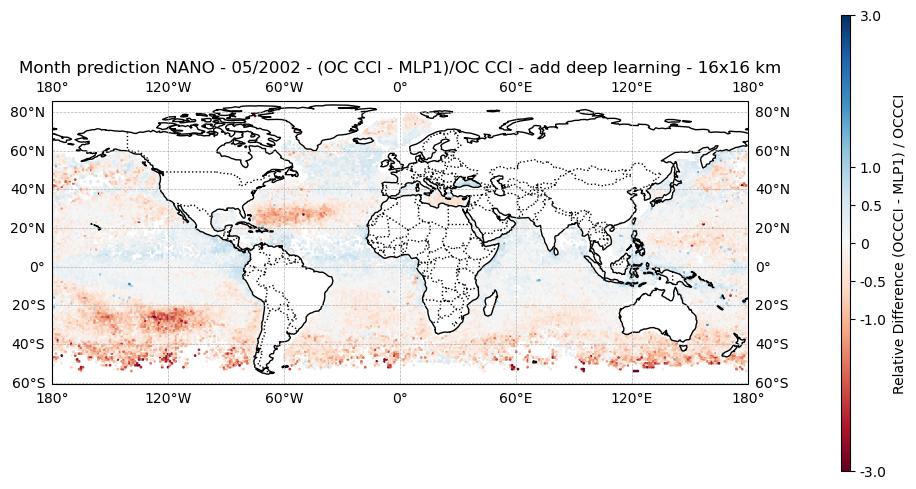

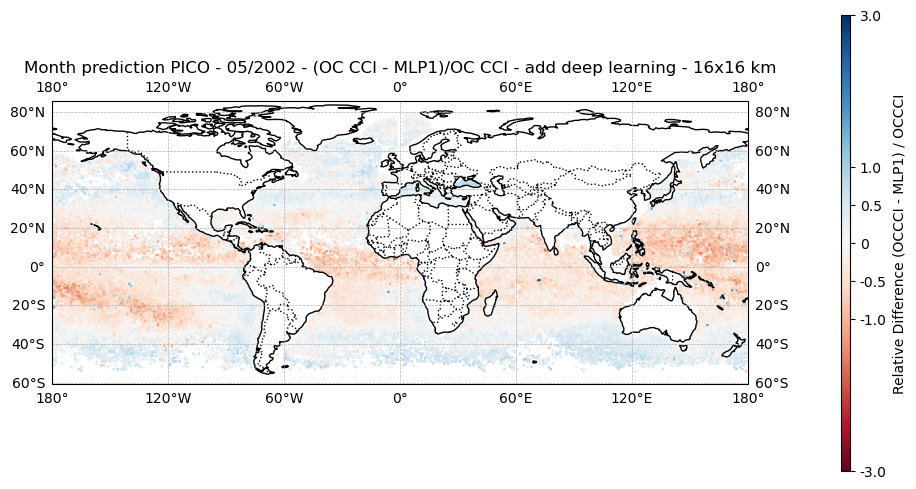

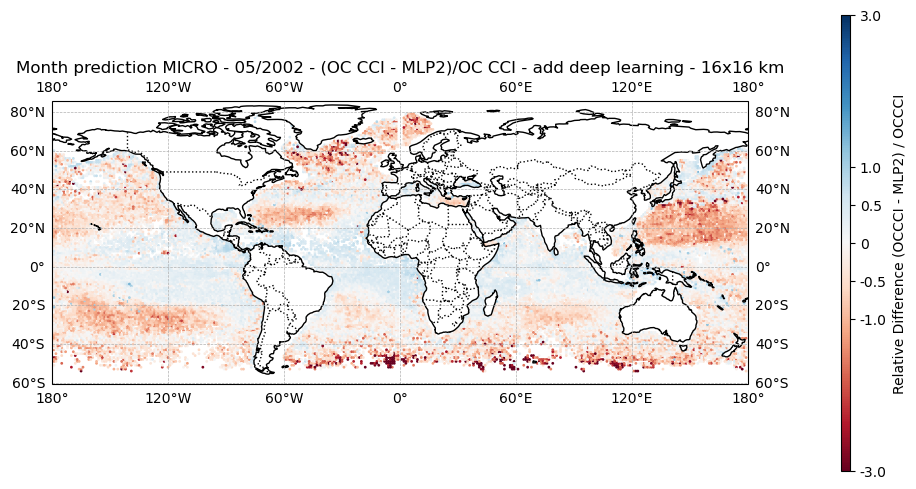

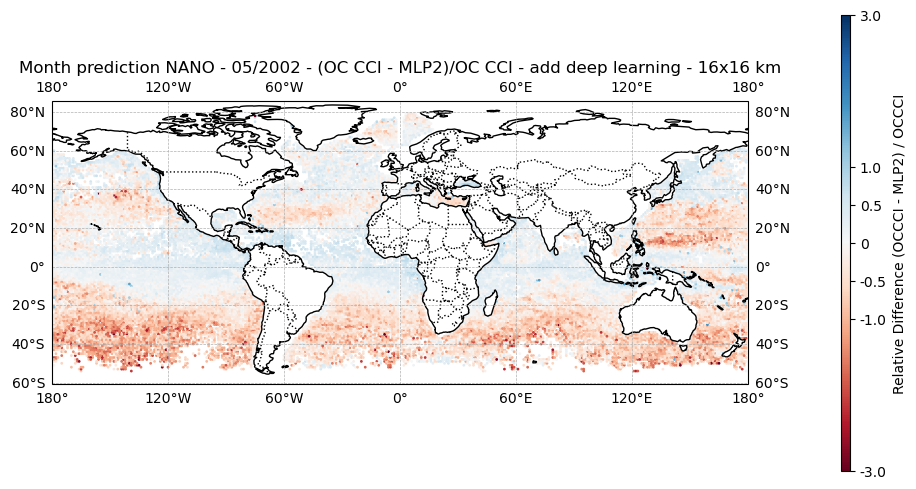

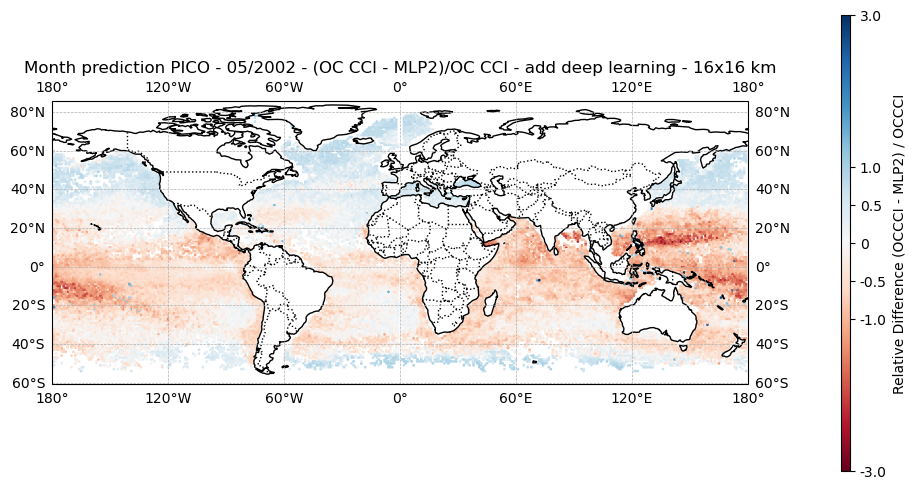

In [60]:
def plot_predictions_difference_frac(ax, longitudes, latitudes, values, title):
    mask = ~np.isnan(values)

    norm = mcolors.Normalize(vmin=-3, vmax=3)

    scatter = ax.scatter(longitudes[mask], latitudes[mask], c=values[mask], cmap='RdBu', s=1,
                         transform=ccrs.PlateCarree(), norm=norm)   

    ax.coastlines(resolution='110m', color='black')
    ax.add_feature(cfeat.BORDERS, linestyle=':', edgecolor='black')
    ax.gridlines(draw_labels=True, linestyle='--', linewidth=0.5)
    ax.set_title(title)

    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=50)
    cbar.set_label('Relative Difference (OCCCI - MLP1) / OCCCI')
    cbar.set_ticks([-3.0, -1.0, -0.5,  0,  0.5, 1.0, 3.0])
    cbar.set_ticklabels(['-3.0', '-1.0', '-0.5', '0', '0.5','1.0','3.0'])


########################### MODEL 1 ###########################
fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_deep_099_PFTS['lon'].values,
    df_add_deep_099_PFTS['lat'].values,
    df_add_deep_099_PFTS['diff_frac_micro'].values,
    title=f'Month prediction MICRO - {month:02d}/{year} - (OC CCI - MLP1)/OC CCI - add deep learning - 16x16 km'
)
plt.tight_layout()
plt.show()

fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_deep_099_PFTS['lon'].values,
    df_add_deep_099_PFTS['lat'].values,
    df_add_deep_099_PFTS['diff_frac_nano'].values,
    title=f'Month prediction NANO - {month:02d}/{year} - (OC CCI - MLP1)/OC CCI - add deep learning - 16x16 km'
)
plt.tight_layout()
plt.show()


fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_deep_099_PFTS['lon'].values,
    df_add_deep_099_PFTS['lat'].values,
    df_add_deep_099_PFTS['diff_frac_pico'].values,
    title=f'Month prediction PICO - {month:02d}/{year} - (OC CCI - MLP1)/OC CCI - add deep learning - 16x16 km'
)
plt.tight_layout()
plt.show()


########################### MODEL 2 ###########################

def plot_predictions_difference_frac(ax, longitudes, latitudes, values, title):
    mask = ~np.isnan(values)

    norm = mcolors.Normalize(vmin=-3, vmax=3)

    scatter = ax.scatter(longitudes[mask], latitudes[mask], c=values[mask], cmap='RdBu', s=1,
                         transform=ccrs.PlateCarree(), norm=norm)   

    ax.coastlines(resolution='110m', color='black')
    ax.add_feature(cfeat.BORDERS, linestyle=':', edgecolor='black')
    ax.gridlines(draw_labels=True, linestyle='--', linewidth=0.5)
    ax.set_title(title)

    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=50)
    cbar.set_label('Relative Difference (OCCCI - MLP2) / OCCCI')
    cbar.set_ticks([-3.0, -1.0, -0.5,  0,  0.5, 1.0, 3.0])
    cbar.set_ticklabels(['-3.0', '-1.0', '-0.5', '0', '0.5','1.0','3.0'])

fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_deep_add_physics_099_PFTS['lon'].values,
    df_add_deep_add_physics_099_PFTS['lat'].values,
    df_add_deep_add_physics_099_PFTS['diff_frac_micro'].values,
    title=f'Month prediction MICRO - {month:02d}/{year} - (OC CCI - MLP2)/OC CCI - add deep learning - 16x16 km'
)
plt.tight_layout()
plt.show()

fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_deep_add_physics_099_PFTS['lon'].values,
    df_add_deep_add_physics_099_PFTS['lat'].values,
    df_add_deep_add_physics_099_PFTS['diff_frac_nano'].values,
    title=f'Month prediction NANO - {month:02d}/{year} - (OC CCI - MLP2)/OC CCI - add deep learning - 16x16 km'
)
plt.tight_layout()
plt.show()

fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_deep_add_physics_099_PFTS['lon'].values,
    df_add_deep_add_physics_099_PFTS['lat'].values,
    df_add_deep_add_physics_099_PFTS['diff_frac_pico'].values,
    title=f'Month prediction PICO - {month:02d}/{year} - (OC CCI - MLP2)/OC CCI - add deep learning - 16x16 km'
)
plt.tight_layout()
plt.show()

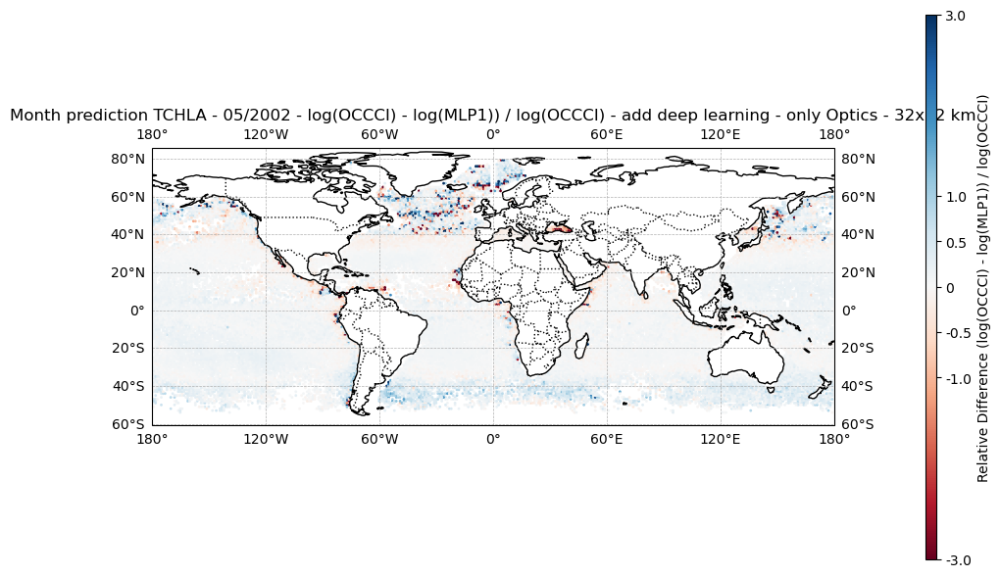

In [51]:
def plot_predictions_difference_frac(ax, longitudes, latitudes, values, title):
    mask = ~np.isnan(values)

    norm = mcolors.Normalize(vmin=-3, vmax=3)

    scatter = ax.scatter(longitudes[mask], latitudes[mask], c=values[mask], cmap='RdBu', s=1,
                         transform=ccrs.PlateCarree(), norm=norm)   

    ax.coastlines(resolution='110m', color='black')
    ax.add_feature(cfeat.BORDERS, linestyle=':', edgecolor='black')
    ax.gridlines(draw_labels=True, linestyle='--', linewidth=0.5)
    ax.set_title(title)

    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=50)
    cbar.set_label('Relative Difference (log(OCCCI) - log(MLP1)) / log(OCCCI)')
    cbar.set_ticks([-3.0, -1.0, -0.5,  0,  0.5, 1.0, 3.0])
    cbar.set_ticklabels(['-3.0', '-1.0', '-0.5', '0', '0.5','1.0','3.0'])

fig = plt.figure(figsize=(10, 6))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_deep_099['lon'].values,
    df_add_deep_099['lat'].values,
    df_add_deep_099['diff_frac_log'].values,
    title=f'Month prediction TCHLA - {month:02d}/{year} - log(OCCCI) - log(MLP1)) / log(OCCCI) - add deep learning - only Optics - 32x32 km'
)
plt.tight_layout()
plt.show()

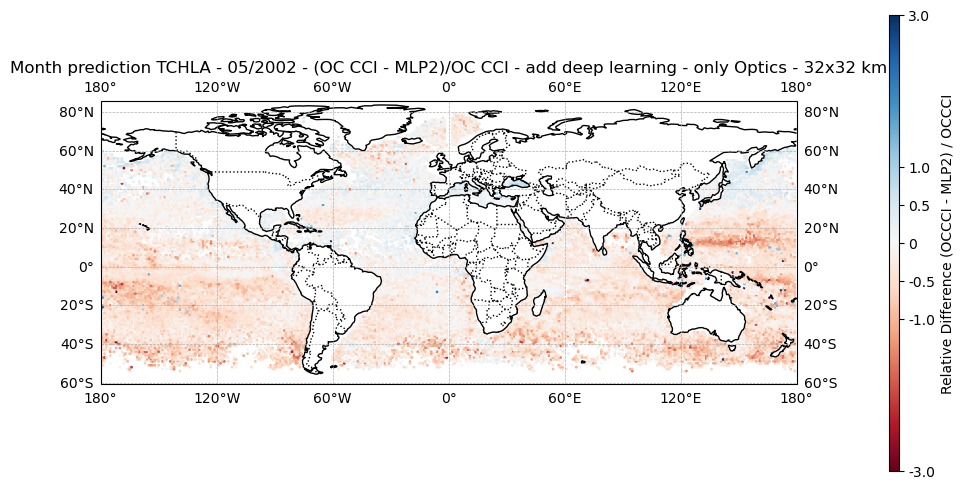

In [59]:
def plot_predictions_difference_frac(ax, longitudes, latitudes, values, title):
    mask = ~np.isnan(values)

    norm = mcolors.Normalize(vmin=-3, vmax=3)

    scatter = ax.scatter(longitudes[mask], latitudes[mask], c=values[mask], cmap='RdBu', s=1,
                         transform=ccrs.PlateCarree(), norm=norm)   

    ax.coastlines(resolution='110m', color='black')
    ax.add_feature(cfeat.BORDERS, linestyle=':', edgecolor='black')
    ax.gridlines(draw_labels=True, linestyle='--', linewidth=0.5)
    ax.set_title(title)

    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=50)
    cbar.set_label('Relative Difference (OCCCI - MLP2) / OCCCI')
    cbar.set_ticks([-3.0, -1.0, -0.5,  0,  0.5, 1.0, 3.0])
    cbar.set_ticklabels(['-3.0', '-1.0', '-0.5', '0', '0.5','1.0','3.0'])

fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_deep_add_physics_099['lon'].values,
    df_add_deep_add_physics_099['lat'].values,
    df_add_deep_add_physics_099['diff_frac'].values,
    title=f'Month prediction TCHLA - {month:02d}/{year} - (OC CCI - MLP2)/OC CCI - add deep learning - only Optics - 32x32 km'
)
plt.tight_layout()
plt.show()

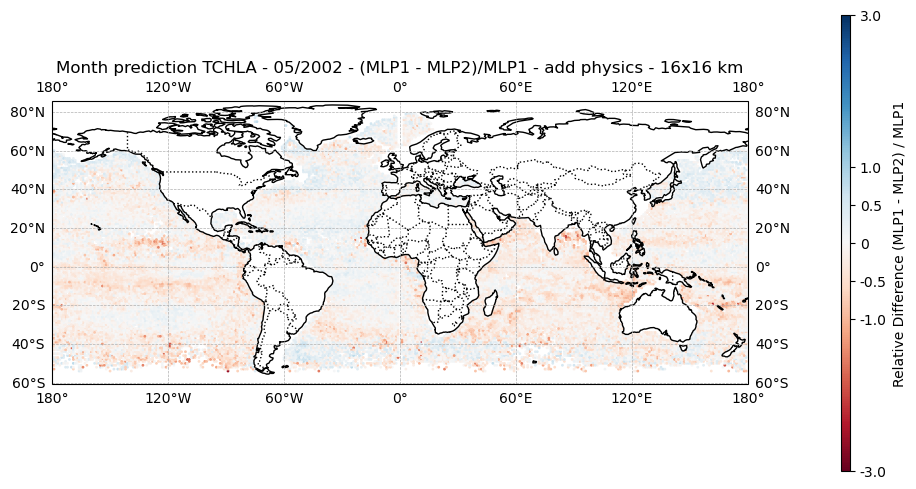

In [60]:
def plot_predictions_difference_frac(ax, longitudes, latitudes, values, title):
    mask = ~np.isnan(values)

    norm = mcolors.Normalize(vmin=-3, vmax=3)

    scatter = ax.scatter(longitudes[mask], latitudes[mask], c=values[mask], cmap='RdBu', s=1,
                         transform=ccrs.PlateCarree(), norm=norm)   

    ax.coastlines(resolution='110m', color='black')
    ax.add_feature(cfeat.BORDERS, linestyle=':', edgecolor='black')
    ax.gridlines(draw_labels=True, linestyle='--', linewidth=0.5)
    ax.set_title(title)

    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=50)
    cbar.set_label('Relative Difference (MLP1 - MLP2) / MLP1')
    cbar.set_ticks([-3.0, -1.0, -0.5,  0,  0.5, 1.0, 3.0])
    cbar.set_ticklabels(['-3.0', '-1.0', '-0.5', '0', '0.5','1.0','3.0'])

fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_physics_099['lon'].values,
    df_add_physics_099['lat'].values,
    df_add_physics_099['diff_frac'].values,
    title=f'Month prediction TCHLA - {month:02d}/{year} - (MLP1 - MLP2)/MLP1 - add physics - 16x16 km'
)
plt.tight_layout()
plt.show()

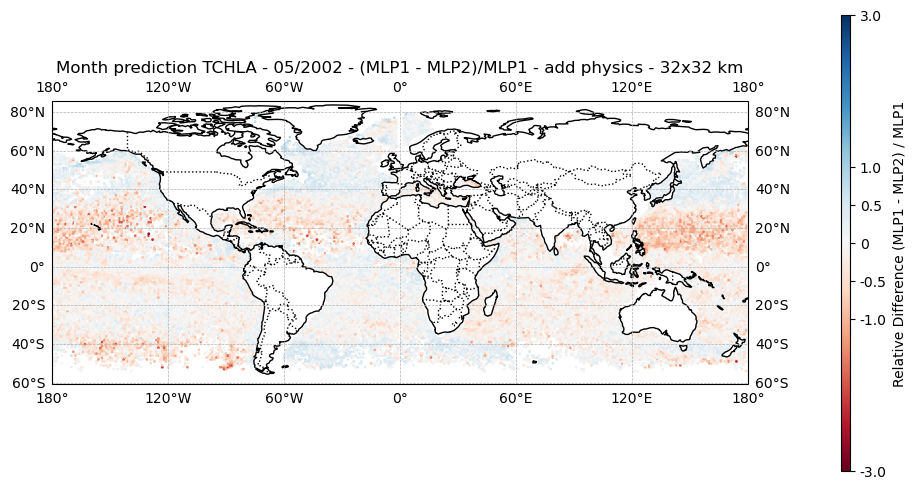

In [37]:
def plot_predictions_difference_frac(ax, longitudes, latitudes, values, title):
    mask = ~np.isnan(values)

    norm = mcolors.Normalize(vmin=-3, vmax=3)

    scatter = ax.scatter(longitudes[mask], latitudes[mask], c=values[mask], cmap='RdBu', s=1,
                         transform=ccrs.PlateCarree(), norm=norm)   

    ax.coastlines(resolution='110m', color='black')
    ax.add_feature(cfeat.BORDERS, linestyle=':', edgecolor='black')
    ax.gridlines(draw_labels=True, linestyle='--', linewidth=0.5)
    ax.set_title(title)

    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=50)
    cbar.set_label('Relative Difference (MLP1 - MLP2) / MLP1')
    cbar.set_ticks([-3.0, -1.0, -0.5,  0,  0.5, 1.0, 3.0])
    cbar.set_ticklabels(['-3.0', '-1.0', '-0.5', '0', '0.5','1.0','3.0'])

fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_physics_05['lon'].values,
    df_add_physics_05['lat'].values,
    df_add_physics_05['diff_frac'].values,
    title=f'Month prediction TCHLA - {month:02d}/{year} - (MLP1 - MLP2)/MLP1 - add physics - 32x32 km'
)
plt.tight_layout()
plt.show()

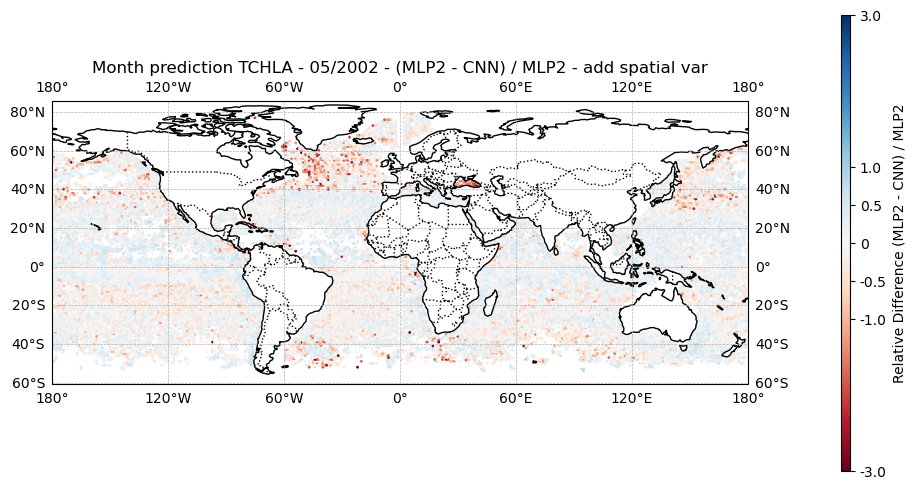

In [38]:
def plot_predictions_difference_frac(ax, longitudes, latitudes, values, title):
    mask = ~np.isnan(values)

    norm = mcolors.Normalize(vmin=-3, vmax=3)

    scatter = ax.scatter(longitudes[mask], latitudes[mask], c=values[mask], cmap='RdBu', s=1,
                         transform=ccrs.PlateCarree(), norm=norm)   

    ax.coastlines(resolution='110m', color='black')
    ax.add_feature(cfeat.BORDERS, linestyle=':', edgecolor='black')
    ax.gridlines(draw_labels=True, linestyle='--', linewidth=0.5)
    ax.set_title(title)

    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=50)
    cbar.set_label('Relative Difference (MLP2 - CNN) / MLP2')
    cbar.set_ticks([-3.0, -1.0, -0.5,  0,  0.5, 1.0, 3.0])
    cbar.set_ticklabels(['-3.0', '-1.0', '-0.5', '0', '0.5','1.0','3.0'])

fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_spatial_var['lon'].values,
    df_add_spatial_var['lat'].values,
    df_add_spatial_var['diff_frac'].values,
    title=f'Month prediction TCHLA - {month:02d}/{year} - (MLP2 - CNN) / MLP2 - add spatial var'
)
plt.tight_layout()
plt.show()

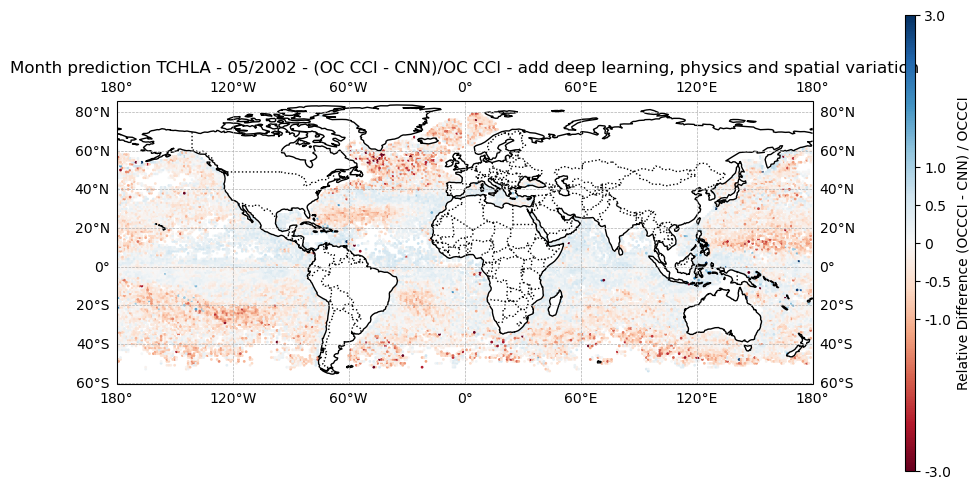

In [39]:
def plot_predictions_difference_frac(ax, longitudes, latitudes, values, title):
    mask = ~np.isnan(values)

    norm = mcolors.Normalize(vmin=-3, vmax=3)

    scatter = ax.scatter(longitudes[mask], latitudes[mask], c=values[mask], cmap='RdBu', s=1,
                         transform=ccrs.PlateCarree(), norm=norm)   

    ax.coastlines(resolution='110m', color='black')
    ax.add_feature(cfeat.BORDERS, linestyle=':', edgecolor='black')
    ax.gridlines(draw_labels=True, linestyle='--', linewidth=0.5)
    ax.set_title(title)

    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.1, aspect=50)
    cbar.set_label('Relative Difference (OCCCI - CNN) / OCCCI')
    cbar.set_ticks([-3.0, -1.0, -0.5,  0,  0.5, 1.0, 3.0])
    cbar.set_ticklabels(['-3.0', '-1.0', '-0.5', '0', '0.5','1.0','3.0'])

fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
plot_predictions_difference_frac(
    ax,
    df_add_deep_add_physics_add_spatial_var['lon'].values,
    df_add_deep_add_physics_add_spatial_var['lat'].values,
    df_add_deep_add_physics_add_spatial_var['diff_frac'].values,
    title=f'Month prediction TCHLA - {month:02d}/{year} - (OC CCI - CNN)/OC CCI - add deep learning, physics and spatial variation'
)
plt.tight_layout()
plt.show()